In [1]:
import os
from collections import defaultdict, Counter
from typing import Mapping
import copy

import numpy as np
import matplotlib.pyplot as plt
# from PIL import Image
from scipy import stats
import seaborn as sns
import pandas as pd
from sklearn.cluster import KMeans
import cv2
import plotly.express as px

plt.rcParams['figure.figsize'] = (12, 12)
plt.rcParams['figure.dpi'] = 120

ImageData = np.ndarray

In [2]:
# helper funcs

def compare_two_images(label_img: Mapping[str, ImageData], cmap=plt.cm.gray):
    plt.figure(figsize=(12, 16))
    i = 0
    for label, data in label_img.items():
        i += 1
        plt.subplot(1,2,i)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(data, cmap=cmap)
        plt.title(label)

# Task 1: Matlab / Python Warm-up (2 marks)

Describe (in words where appropriate) the result/function of each of the following commands of your preferred language in report. Please utilize the inbuilt help() command if you are unfamiliar with the these functions.

Hint

Do the necessary typecasting (uint8 and double)when processing and displaying the image data in the following tasks. For Python, please be aware of the default datatype of different libraries (e.g. Image, matplotlib,cv2). An improper datatype of image will cause many troubles when you want to displaythe image

In [3]:
a = np.array([[2,3,4], [5,2,200]]) # (1) 
# create n-dimensional array of shape (2, 3)

b = a[:,1]  # (2) 
# assign first column of ndarray in a to b

f = np.random.randn(400,1) + 3 # (3)
# generate an array of shape (400, 1) consisting of random samples from standard normal distribution X ~ N(0, 1), then add 3

g = f[f>0] * 3 # (4) 
# select values greater than 0, multiply by 3, and assign the resulting one dimensional array to g

x = np.zeros(100) + 0.45  # (5) 
# generate an array of zeros of shape (100, ), and add 0.45. In other words, array of a hundred 0.45

y = 0.5 * np.ones([1, len(x)]) # (6) 
# generate an array of ones of shape (1, 100), and add 0.5.

z = x + y # (7) 
# element-wise addition between x and y, result assigned to z

a = np.linspace(1, 499, 250, dtype=int) # (8) 
# create an array of length 250 using integers from the interval [1, 499], with equal spacing between the elements

b = a[::-2] # (9) 
# reverse array a, skip every other element (drop elments at idx 1, 3, 5...), and assign to b

b[b >50] = 0 # (10) 
# set elements in b greater than 50 to 0

# Task 2: Basic Coding Practice (1 marks)

Write functions to process an input grayscale image with following requirements, where you need to write a script to load the given image in the Lab package, apply each transformation to the input, and display the results in a figure. For Matlab, you can use subplot()function; for Python, we suggest to use matplotlib.pyplot.subplot(). Please notice that each subplot needs to be labelled with an appropriate title. (0.2 marks each)


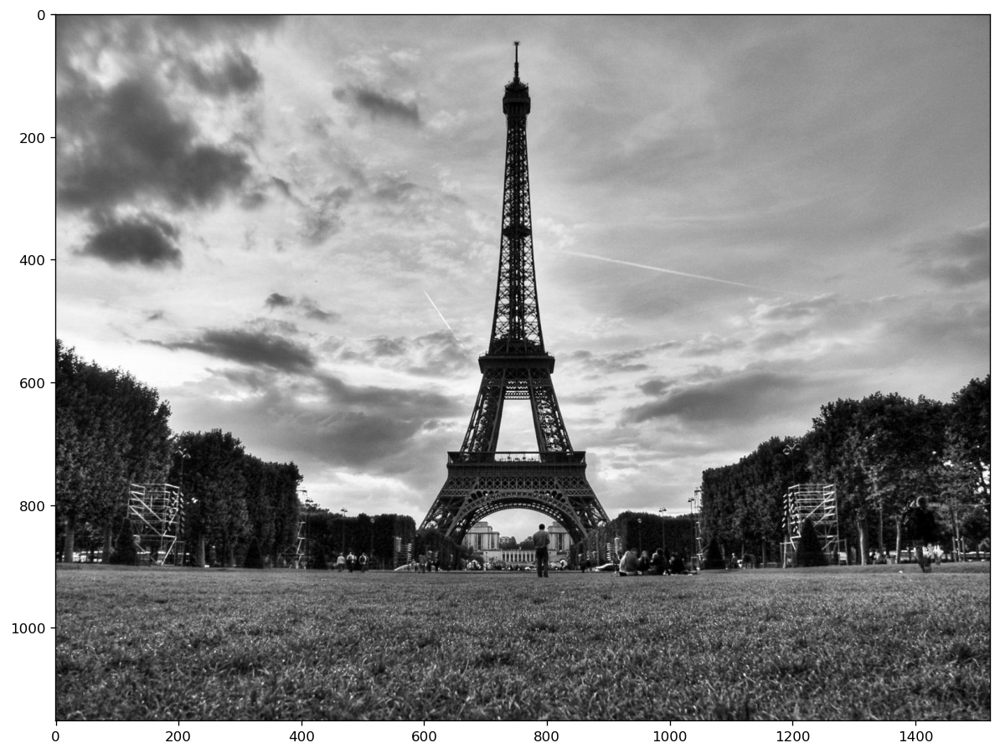

In [49]:
img = plt.imread('images/Atowergray.jpg', format='jpeg')
plt.imshow(img, cmap=plt.cm.gray)

## 1. Negative

In [50]:
x = np.arange(256)
reverse_x = x[::-1]
negative_map = {x[i]: reverse_x[i] for i in range(256)}

In [51]:
original_shape = img.shape
img = img.reshape(original_shape[0] * original_shape[1])
negative_img = np.array(list(map(lambda x: negative_map[x], img)))

assert all([img[i] + negative_img[i] == 255 for i in range(len(img))])

img = img.reshape(original_shape)
negative_img = negative_img.reshape(original_shape)

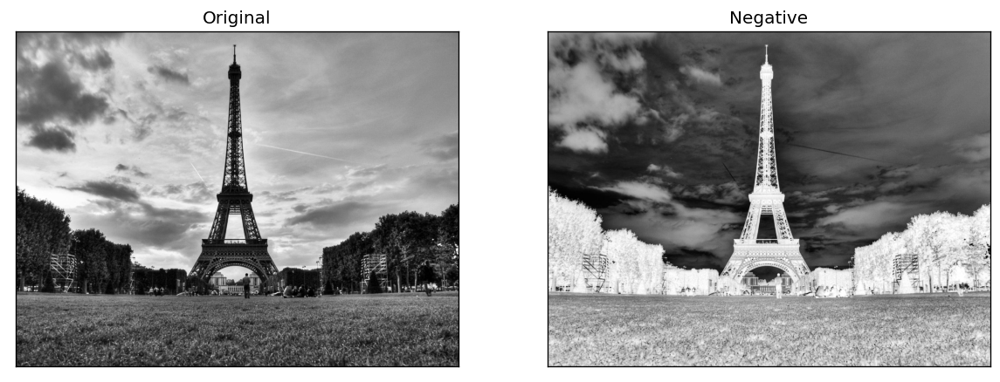

In [52]:
compare_two_images(
    label_img={
        'Original': img, 
        'Negative': negative_img
    }
)

## 2. Horizontal flip

In [53]:
flipped = copy.deepcopy(img)
flipped = np.array([np.flip(row) for row in img])

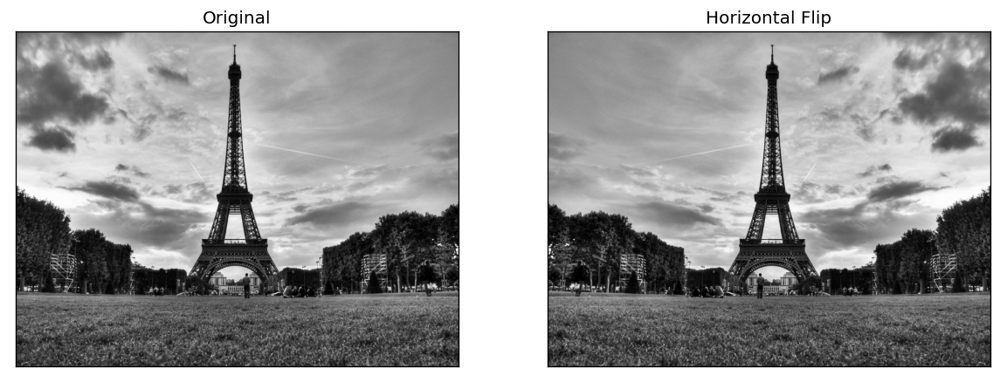

In [54]:
compare_two_images(
    label_img={
        'Original': img, 
        'Horizontal Flip': flipped
    }
)


## 3. Swap colour channels

In [55]:
images = []
filenames = []

# read color images
for f in os.listdir('images'):
    if f.startswith('image') and f.endswith('.jpg'):
        images += plt.imread(f'images/{f}', format='jpeg'),
        filenames += f,

In [ ]:
ImageData = np.ndarray

def swap_red_green(arr: ImageData) -> ImageData:
    new_arr = copy.deepcopy(arr)
    
    for i in range(len(arr)):
        for j in range(len(arr[0])):
            r, g, b = arr[i][j]
            new_arr[i][j] = [g, r, b]
            
    return new_arr

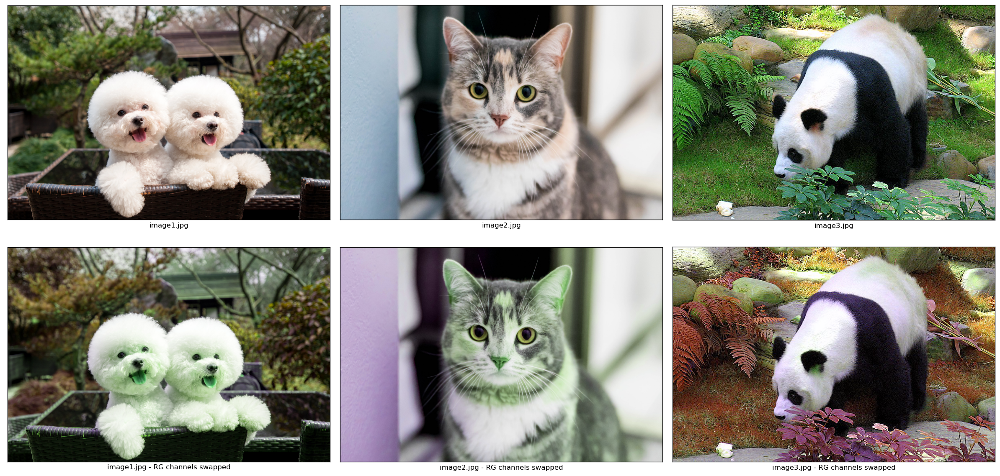

In [56]:
plt.figure(figsize=(20, 10))

# plot original
for i in range(len(images)):
    plt.subplot(2,3,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(images[i])
    plt.xlabel(filenames[i])

modified_images = [swap_red_green(img) for img in images]

# plot swapped
for i in range(len(modified_images)):
    plt.subplot(2,3,i+1+len(modified_images))
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(modified_images[i])
    plt.xlabel(f'{filenames[i]} - RG channels swapped')
    
plt.tight_layout()

## 4. Average with horizontal flip

In [12]:
avg_img = copy.deepcopy(img)
original_shape = avg_img.shape

avg_img = avg_img.flatten()
flipped = flipped.flatten()

avg_img = (avg_img + flipped) / 2
avg_img = avg_img.reshape(original_shape)
flipped = flipped.reshape(original_shape)

assert avg_img.shape == original_shape, f'{avg_img.shape}, {original_shape}'

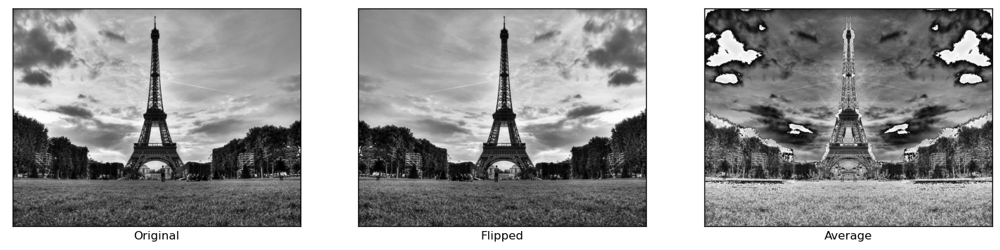

In [13]:
images = [img, flipped, avg_img]
filenames = ['Original', 'Flipped', 'Average']

plt.figure(figsize=(15, 5))
for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(images[i], cmap=plt.cm.gray)
    plt.xlabel(filenames[i])

## 5. Offset and clip

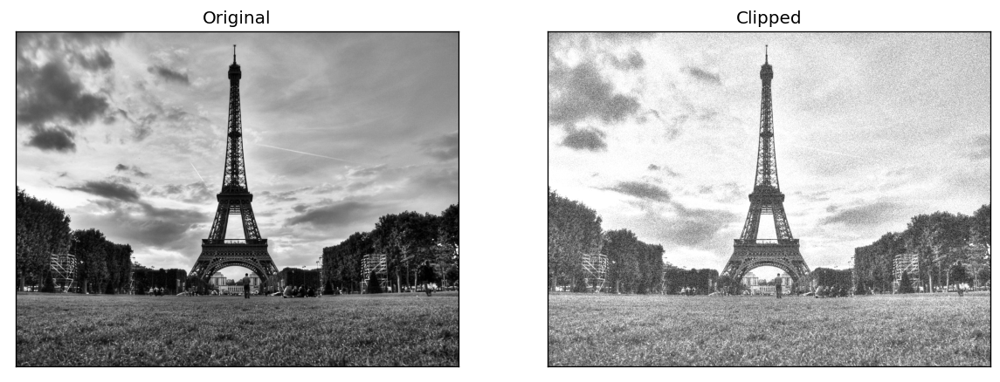

In [14]:
offset = np.random.randint(0, 128, original_shape)
clip = img + offset
clip[clip > 255] = 255

compare_two_images(
    label_img={
        'Original': img, 
        'Clipped': clip
    }
)

# Task 3: Basic Image I/O (2 marks)

Using image1.jpg, develop short computer code that does the following tasks:

a. Read this image from its JPGfile, and resize the image to 384x 256in columns x rows (0.2marks).

b. Convert the colour image into three grayscale channels, i.e., R,G,B images, and display each of the three channel grayscale images separately (0.2marksfor each channel, 0.6marksin total).

c. Compute the histograms for each of the grayscale images, and display the 3 histograms (0.2marks for each histogram, 0.6marks in total).

d. Apply  histogram  equalisation  to  the  resized  image  and  its  three  grayscale channels, and then display the 4 histogram equalization images(0.15marks for each histogram, 0.6marks in total). (Hint:you can use in built functions for  implementing  histogram  equalisation.e.g. histeq()in  Matlab or cv2.equalizeHist() in Python)

In [15]:
img = cv2.imread(f'images/image1.jpg')

## a. Resize

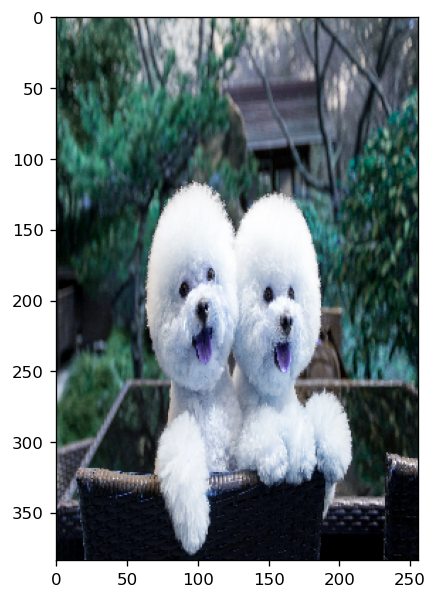

In [16]:
resized = cv2.resize(img, (256, 384))
plt.figure(figsize=(10, 6))
plt.imshow(resized)

## b. Split into 3 grayscale



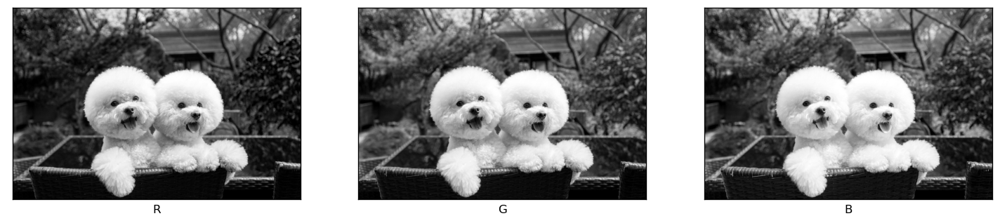

In [17]:
split_images = []

filenames = ['R', 'G', 'B']
plt.figure(figsize=(15, 5))
for k in range(3):
    plt.subplot(1, 3, k+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)

    plt.imshow(img[:,:,k], cmap=plt.cm.gray)
    plt.xlabel(filenames[k])
    split_images += img[:,:,k],

## c. Compute histograms for each of the grayscale images and display.

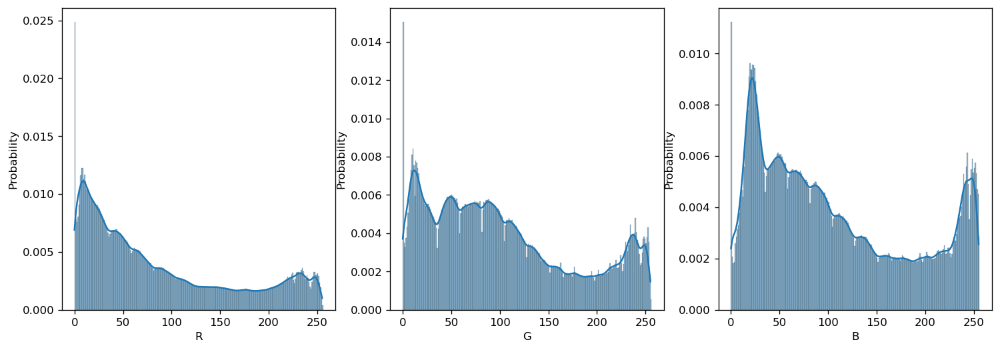

In [18]:
plt.figure(figsize=(15, 5))
i = 0
for title, im in zip(filenames, split_images):
    i += 1
    plt.subplot(1, 3, i)
    sns.histplot(
        im.flatten(), 
        binrange=(0, 256), 
        binwidth=1, 
        stat='probability', 
        kde=True
    )
    plt.xlabel(title)

## 4. Histogram Equalisation

Text(0.5, 0, 'Equalized')

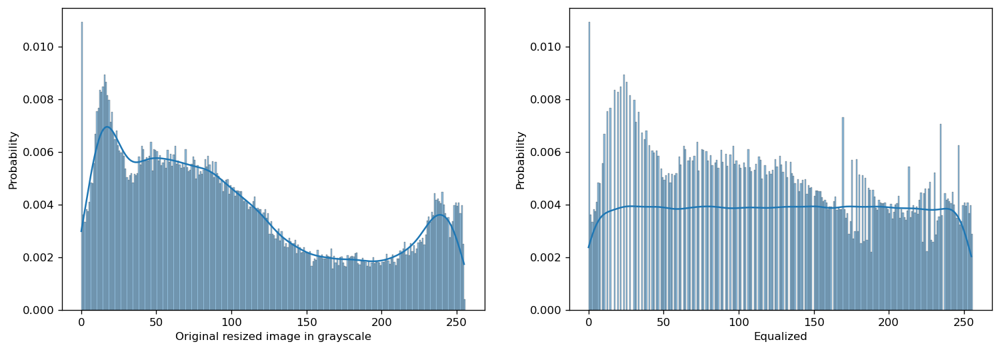

In [19]:
plt.figure(figsize=(15, 5))

original_shape = resized.shape
grayimg = cv2.cvtColor(resized, cv2.COLOR_BGR2GRAY)

plt.subplot(1, 2, 1)
sns.histplot(
    grayimg.flatten(), 
    binrange=(0, 256), 
    binwidth=1, 
    stat='probability', 
    kde=True
)
plt.xlabel('Original resized image in grayscale')

grayimg_equalized = cv2.equalizeHist(grayimg.flatten())
grayimg_equalized = grayimg_equalized.reshape(original_shape[:-1])

plt.subplot(1, 2, 2)
sns.histplot(
    grayimg_equalized.flatten(), 
    binrange=(0, 256), 
    binwidth=1, 
    stat='probability', 
    kde=True
)
plt.xlabel('Equalized')

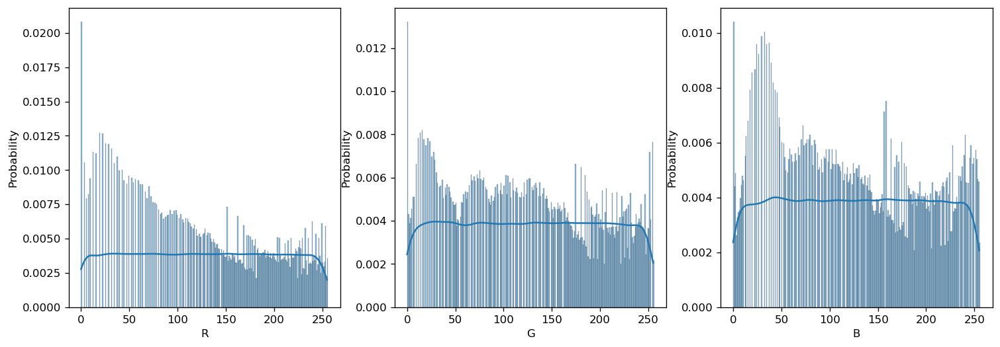

In [20]:
plt.figure(figsize=(15, 5))
filenames = ['R', 'G', 'B']

for i, title in enumerate(filenames):

    # extract color channel
    extracted = resized[:,:,i]

    equalized = cv2.equalizeHist(extracted)
    
    plt.subplot(1, 3, i+1)
    sns.histplot(
        equalized.flatten(), 
        binrange=(0, 256), 
        binwidth=1, 
        stat='probability', 
        kde=True
    )
    plt.xlabel(title)

# Task 4: Colour space conversion (3 marks)

## 1. RGBtoYUV Conversion

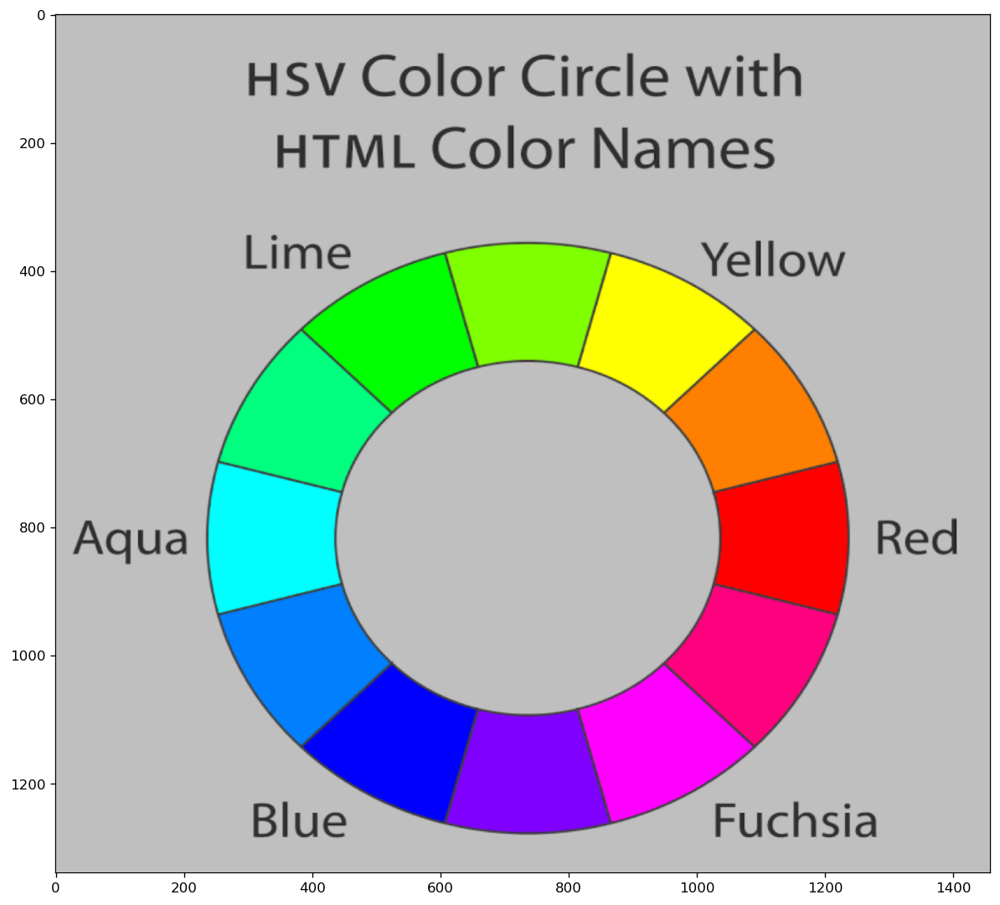

In [3]:
img = plt.imread(f'images/Figure2-a.png')
plt.imshow(img)

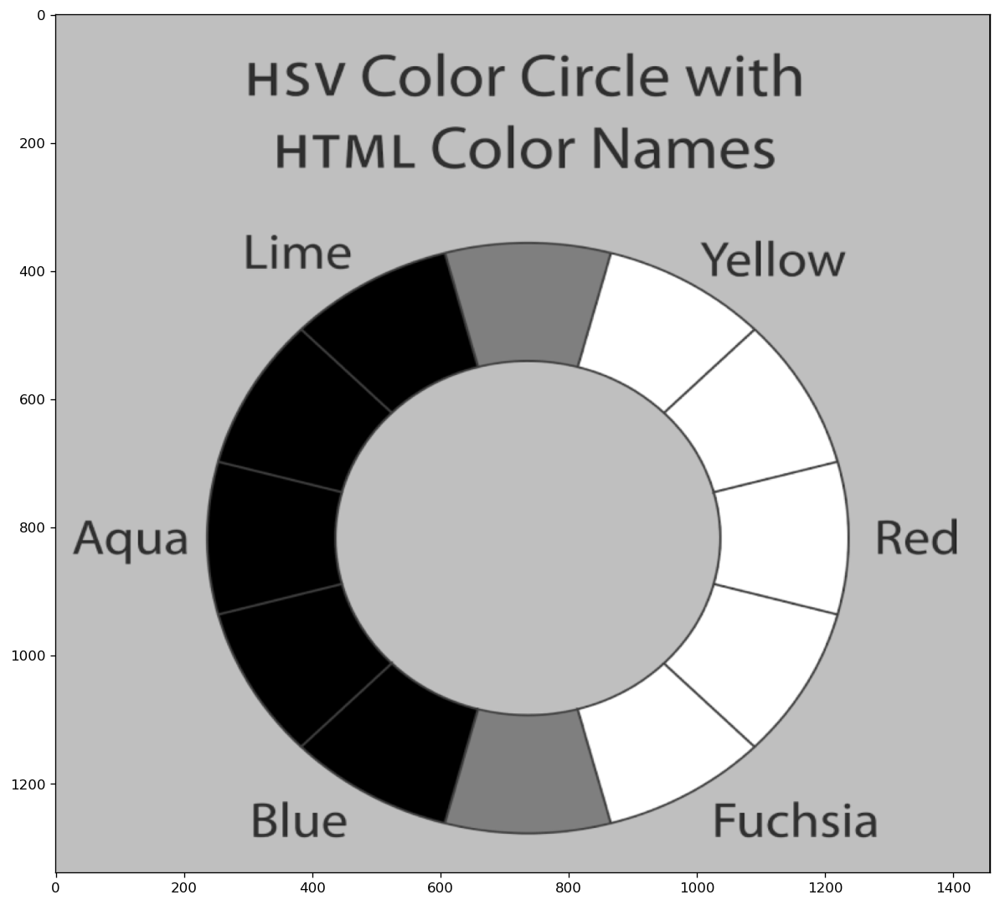

In [4]:
plt.imshow(img[:,:,0], cmap=plt.cm.gray)

In [5]:
def cvRGB2YUV(img: ImageData) -> ImageData:
    new_img = copy.deepcopy(img)
    
    for i in range(len(img)):
        for j in range(len(img[0])):
            rgb = img[i][j]
            r, g, b = rgb
            y = rgb @ [0.299, 0.587, 0.114]
            u = b - y
            v = r - y #C_r
            new_img[i][j] = np.array([y, u, v])
    return new_img

In [6]:
img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)
img = img / 255
new_img = cvRGB2YUV(img)

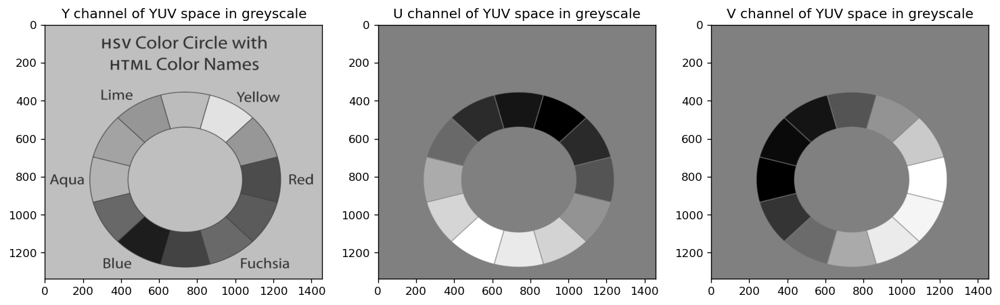

In [9]:
plt.figure(figsize=(15, 5))
channels = ['Y', 'U', 'V']

for i, title in enumerate(channels):    
    plt.subplot(1, 3, i+1)
    plt.imshow(new_img[:,:,i], cmap=plt.cm.gray)
    plt.title(f'{channels[i]} channel of YUV space in greyscale')

## 2. RGBtoYUV Conversion & Partitioning

In [26]:
img = plt.imread(f'images/Figure2-b.png')
original_shape = img.shape

In [27]:
img.shape

(858, 2083, 4)

In [28]:
img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)
img[0,:10,:]

array([[0.        , 0.        , 0.        ],
       [0.9372549 , 0.25882354, 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314],
       [0.9372549 , 0.2509804 , 0.20784314]], dtype=float32)

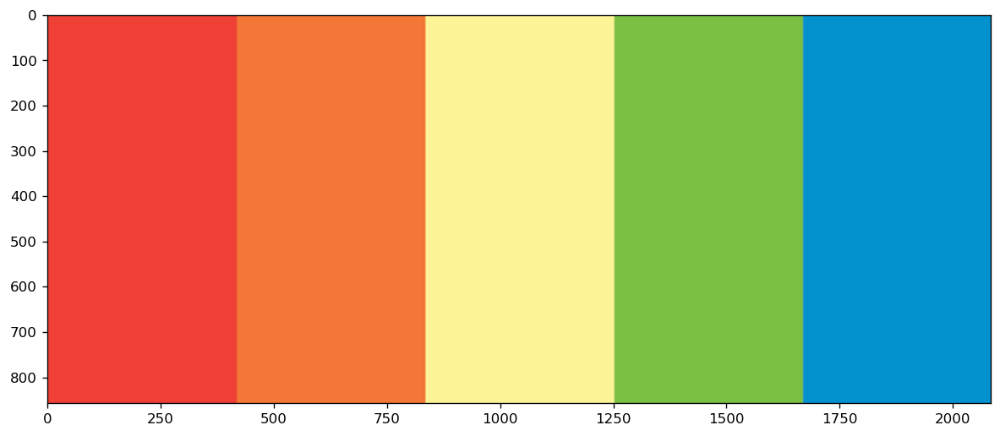

In [29]:
plt.imshow(img)

In [30]:
original_shape = img.shape
img = img.reshape((img.shape[0] * img.shape[1], img.shape[2]))

In [31]:
# while we know k should be 5 from looking at the image, we can also use empirical methods to determine the optimum k
kmeans = KMeans(n_clusters=5)
pred = kmeans.fit_predict(img)
pred = pred.reshape(original_shape[:-1])

In [32]:
# map predicted class label to some greyscale color to visualize the partition

color_mapping = {idx: val for idx, val in enumerate(np.linspace(0, 1, 5))}
tmp = np.zeros(pred.shape, dtype=np.float32)

for i in range(len(pred)):
    for j in range(len(pred[0])):
        tmp[i][j] = color_mapping[pred[i][j]]

In [33]:
print('class: greyscale intensity')
for i in range(5):
    print(f"{i:^5}: {color_mapping[i]:^3.2f}")

class: greyscale intensity
  0  : 0.00
  1  : 0.25
  2  : 0.50
  3  : 0.75
  4  : 1.00


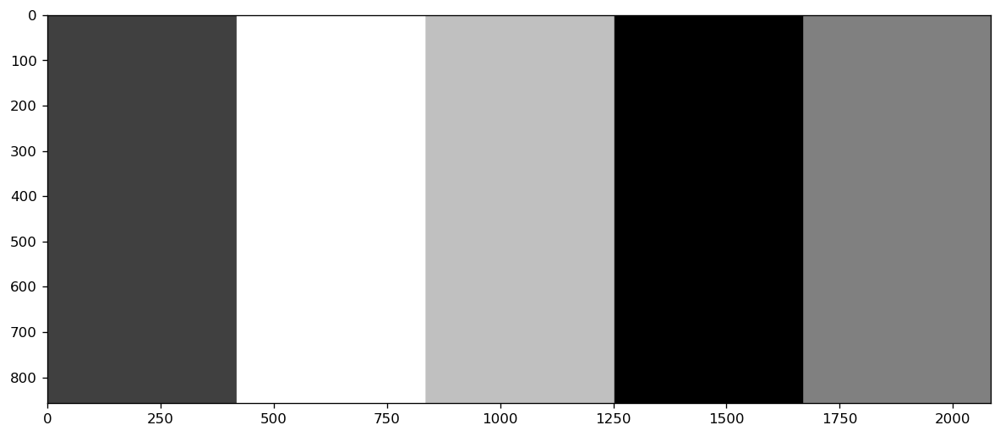

In [34]:
plt.imshow(tmp, cmap=plt.cm.gray)

In [35]:
img = img.reshape(original_shape)
# img = img / 255
new_img = cvRGB2YUV(img)

In [36]:
cumsum = defaultdict(float)

for i in range(len(img)):
    for j in range(len(img[0])):
        group_idx = pred[i][j]
        cumsum[group_idx] += new_img[i][j][0]

In [37]:
classes_count = Counter(pred.flatten())
classes_count

scores = [cumsum[i] / classes_count[i] for i in range(5)]

In [38]:
scores

[0.614641043079435,
 0.4501589623203606,
 0.43352913030065193,
 0.9257567050957872,
 0.5830193593725173]

Average Y value:
- Red: 0.61
- Orange: 0.45
- Yellow: 0.43
- Green: 0.93
- Blue: 0.58


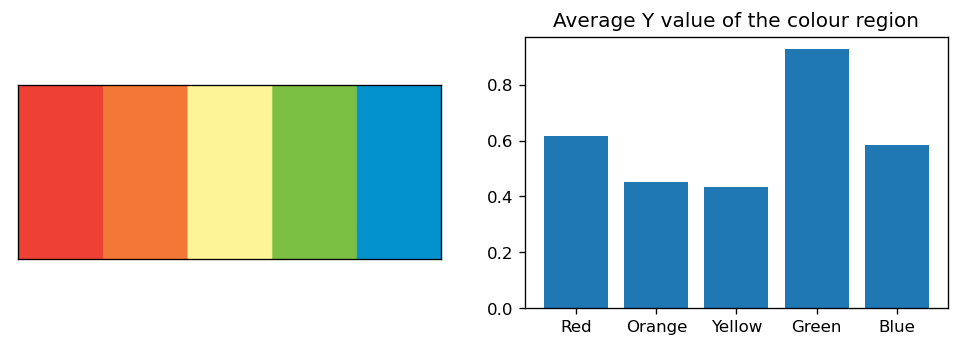

In [39]:
plt.figure(figsize=(10, 3))

plt.subplot(1, 2, 1)
plt.xticks([])
plt.yticks([])
plt.grid(False)
plt.imshow(img)

plt.subplot(1, 2, 2)
plt.bar(['Red', 'Orange', 'Yellow', 'Green', 'Blue'], scores)
plt.title('Average Y value of the colour region')

print('Average Y value:')
for col, score in zip(['Red', 'Orange', 'Yellow', 'Green', 'Blue'], scores):
    print(f"- {col}: {score:3.2f}")

# Task 5: Image Denoising via a Gaussian and Bilateral Filter (9 marks)

## 1.

- Crop and resize to 512 x 512 and convert to grayscale
- Add gaussian noise

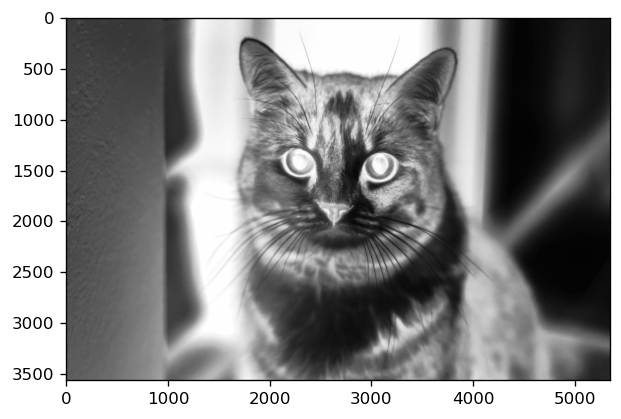

In [64]:
img = plt.imread(f'images/image2.jpg')
img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
plt.figure(figsize=(8, 4))
plt.imshow(img, cmap=plt.cm.Greys)

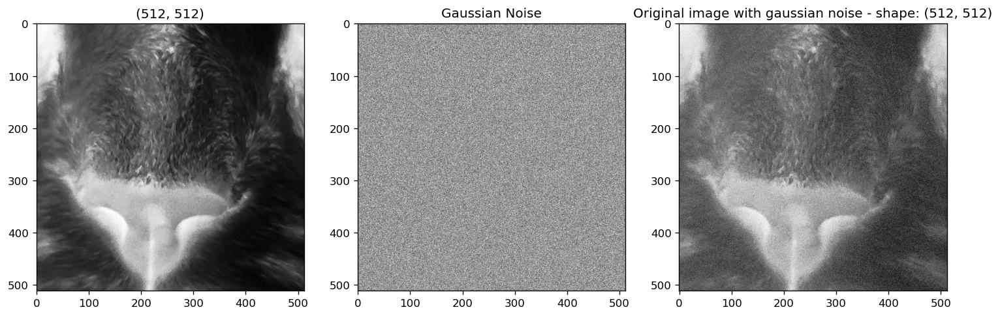

In [65]:
plt.figure(figsize=(15, 5))

target_res = (512, 512)
n_rows, n_cols = img.shape
x = (n_rows // 2) - (target_res[0] // 2)
y = (n_cols // 2) - (target_res[1] // 2)
cropped = img[x:x+target_res[0],y:y+target_res[1]]
plt.subplot(1, 3, 1)
plt.imshow(cropped, cmap=plt.cm.Greys)
plt.title(cropped.shape)

noise = np.random.normal(0, 15, size=target_res)
plt.subplot(1, 3, 2)
plt.imshow(noise, cmap=plt.cm.Greys)
plt.title('Gaussian Noise')

cropped_n = cropped + noise
plt.subplot(1, 3, 3)
plt.title('Original image with gaussian noise - shape: ' + str(cropped_n.shape))
plt.imshow(cropped_n, cmap=plt.cm.Greys)

Text(0.5, 0, 'With Gaussian Noise (mean=0, stdev=15)')

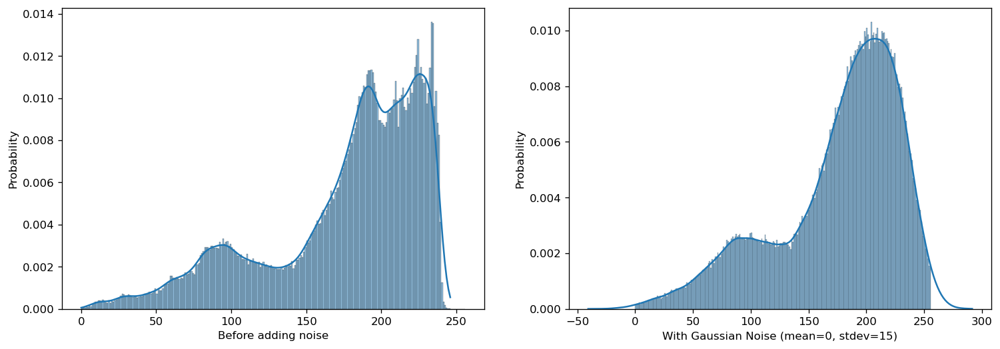

In [66]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
sns.histplot(
    cropped.flatten(), 
    binrange=(0, 256), 
    binwidth=1, 
    stat='probability', 
    kde=True
)
plt.xlabel('Before adding noise')

plt.subplot(1, 2, 2)
sns.histplot(
    cropped_n.flatten(), 
    binrange=(0, 256), 
    binwidth=1, 
    stat='probability', 
    kde=True
)
plt.xlabel('With Gaussian Noise (mean=0, stdev=15)')

In [67]:
cropped_n = np.clip(cropped_n, 0, 255) / 255

## 2. Gaussian Filter

### Implementation

In [68]:
sigma = 15
kernel_size = (11, 11)

In [69]:
def my_Gauss_filter(img, kernel):
    assert kernel.shape[0] == kernel.shape[1]
    
    padding = kernel.shape[0] // 2
    
    padded_img = np.pad(img, padding)
    new_img = np.zeros(padded_img.shape)
    
    for i in range(padding, len(padded_img) - padding):
        for j in range(padding, len(padded_img[0]) - padding):
            new_img[i][j] = np.sum(np.multiply(
                padded_img[i-padding:i+padding+1, j-padding:j+padding+1], 
                kernel
            ))
    return new_img[padding:padding+img.shape[0], padding:padding+img.shape[1]]

def create_filter(sigma, kernel_size):
    arr = np.zeros(kernel_size)
    center = (kernel_size[0] // 2, kernel_size[1] // 2)
    
    for u in range(kernel_size[0]):
        for v in range(kernel_size[1]):
            x, y = center[0] - u, center[1] - v
            exp = -(x ** 2 + y ** 2) / (sigma ** 2)
            arr[u][v] = 0.5 * np.pi * (sigma ** 2) * (np.e ** exp)
            
    arr /= arr.sum()
    return arr
        
kernel = create_filter(sigma, kernel_size)
blurred_img = my_Gauss_filter(cropped_n, kernel)
assert cropped_n.shape == blurred_img.shape

Text(0.5, 0, 'Gaussian blur (CV2)')

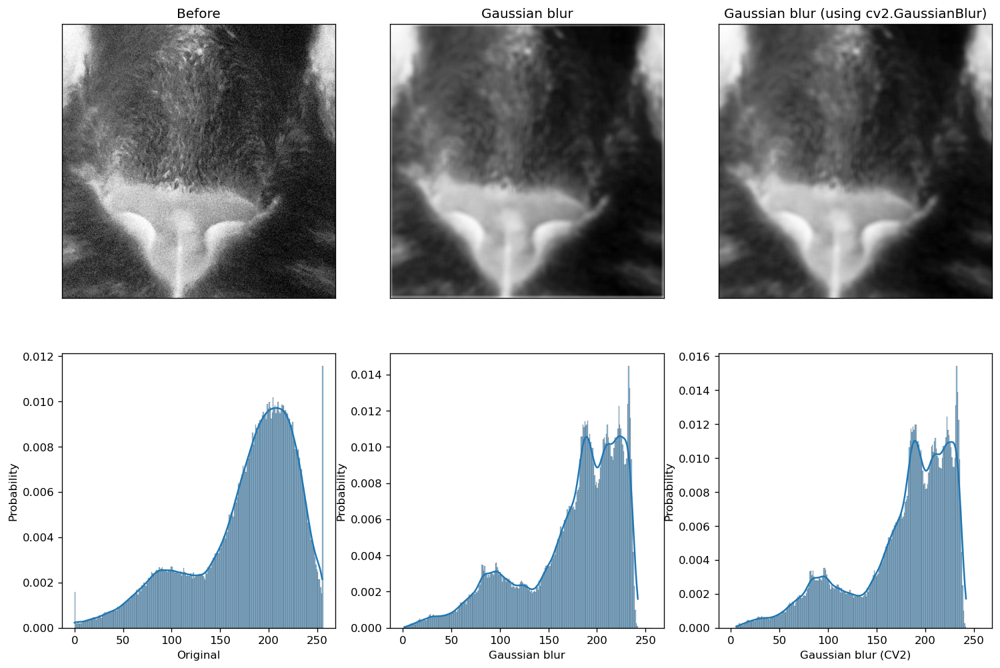

In [70]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.xticks([])
plt.yticks([])
plt.imshow(cropped_n, cmap=plt.cm.Greys)
plt.title('Before')

plt.subplot(2, 3, 2)
plt.xticks([])
plt.yticks([])
plt.imshow(blurred_img, cmap=plt.cm.Greys)
plt.title('Gaussian blur')

blurred = cv2.GaussianBlur(cropped_n, kernel_size, 15)
plt.subplot(2, 3, 3)
plt.xticks([])
plt.yticks([])
plt.imshow(blurred, cmap=plt.cm.Greys)
plt.title('Gaussian blur (using cv2.GaussianBlur)')

plt.subplot(2, 3, 4)
sns.histplot(
    cropped_n.flatten() * 255, 
    binrange=(0, 256), 
    binwidth=1, 
    stat='probability', 
    kde=True
)
plt.xlabel('Original')

plt.subplot(2, 3, 5)
sns.histplot(
    blurred_img.flatten() * 255, 
    binrange=(0, 256), 
    binwidth=1, 
    stat='probability', 
    kde=True
)
plt.xlabel('Gaussian blur')

plt.subplot(2, 3, 6)
sns.histplot(
    blurred.flatten() * 255, 
    binrange=(0, 256), 
    binwidth=1, 
    stat='probability', 
    kde=True
)
plt.xlabel('Gaussian blur (CV2)')

### Try various sigma values

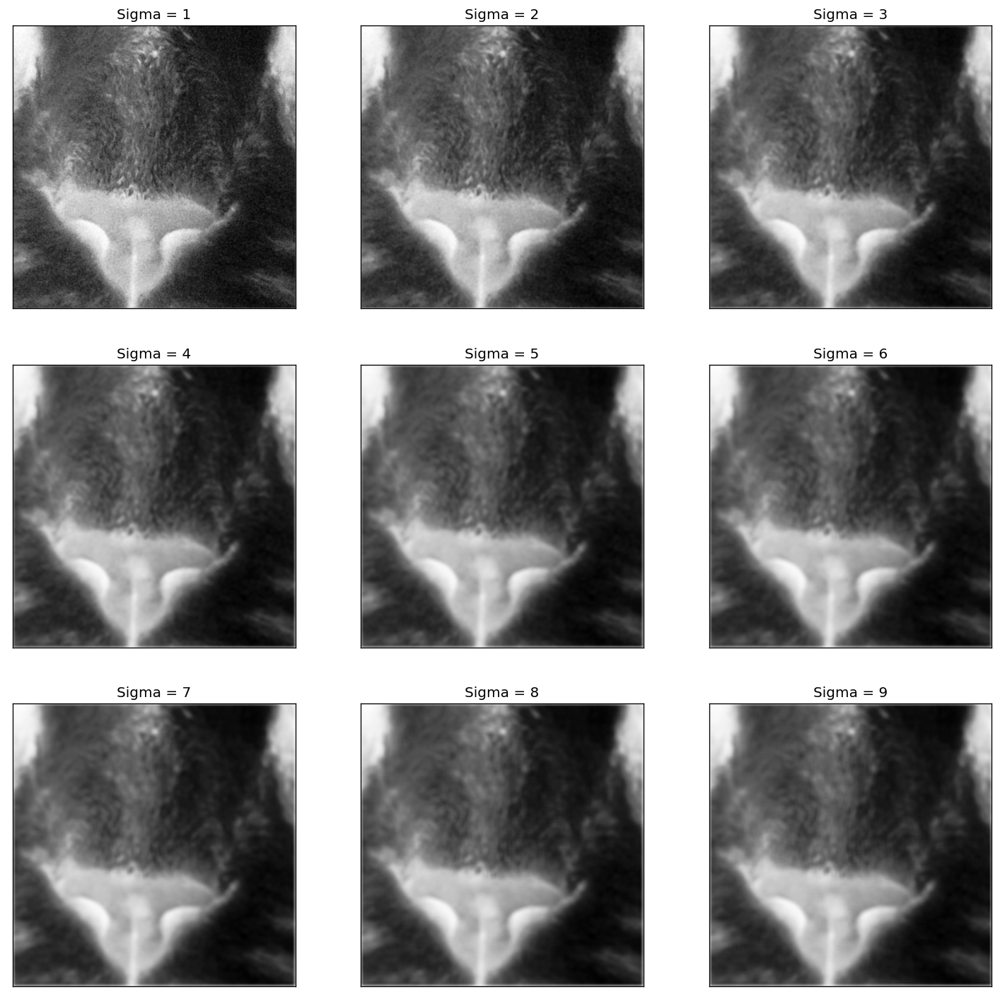

In [71]:
i = 0
plt.figure(figsize=(15, 15))
for sigma in np.arange(1, 10):
    kernel_s = create_filter(sigma, kernel_size)
    blurred_img = my_Gauss_filter(cropped_n, kernel_s)
    i += 1
    
    plt.subplot(3, 3, i)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(blurred_img, cmap=plt.cm.Greys)
    plt.title(f'Sigma = {sigma}')

## Image Denoising via a Bilateral Filter (Challenge task: this task will be difficult for most students to complete.) (5 marks)

In [72]:
def my_Bilateral_filter(noisy_image, my_5x5_gausskernel, colour_sigma):
    return bilateral_filter_grey(noisy_image, my_5x5_gausskernel, colour_sigma)

def bilateral_filter_grey(img, kernel_s, sigma_r):
    assert img.max() <= 1
    
    padding = kernel_s.shape[0] // 2
    padded_img = np.pad(img, padding)
    new_img = np.zeros(padded_img.shape)
    
    for i in range(padding, len(padded_img) - padding):
        for j in range(padding, len(padded_img[0]) - padding):
            # create intensity kernel_r
            intensity_diff = np.abs(padded_img[i-padding:i+padding+1, j-padding:j+padding+1] - padded_img[i][j])
            kernel_r = stats.norm.pdf(intensity_diff, loc=0, scale=sigma_r)
#             kernel_r /= kernel_r.sum()
            
            # multiply the filters with corresponding region in image, then divide by sum of product of kernels to normalize
            new_img[i][j] = np.sum(
                padded_img[i-padding:i+padding+1, j-padding:j+padding+1] * kernel_s * kernel_r
            ) / np.sum(kernel_s * kernel_r)
            
    return new_img[padding:padding+img.shape[0], padding:padding+img.shape[1]]

def create_filter(sigma, kernel_size):
    arr = np.zeros(kernel_size)
    center = (kernel_size[0] // 2, kernel_size[1] // 2)
    
    for u in range(kernel_size[0]):
        for v in range(kernel_size[1]):
            x, y = center[0] - u, center[1] - v
            exp = -(x ** 2 + y ** 2) / (sigma ** 2)
            arr[u][v] = 0.5 * np.pi * (sigma ** 2) * (np.e ** exp)
            
#     arr /= arr.sum()
    return arr

In [73]:
sigma_s = 15 # space
sigma_r = 0.4 # intensity
kernel_size = (5, 5)

In [74]:
kernel_s = create_filter(sigma_s, kernel_size)
denoised = my_Bilateral_filter(cropped_n, my_5x5_gausskernel=kernel_s, colour_sigma=sigma_r)

Text(0.5, 1.0, 'Bilateral Filter (OpenCV2)')

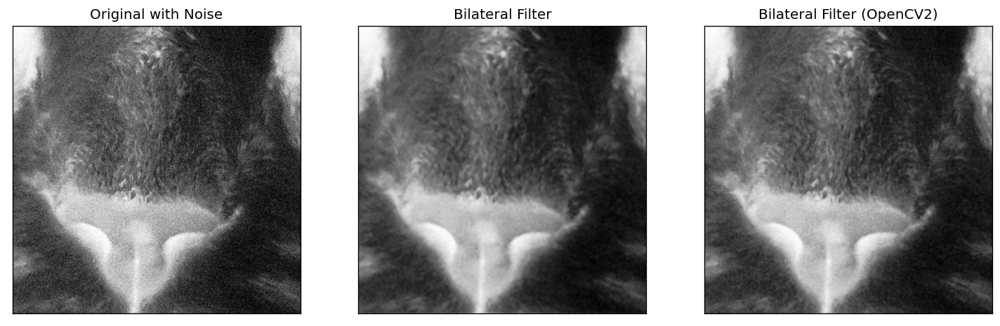

In [75]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.xticks([])
plt.yticks([])
plt.imshow(cropped_n, cmap=plt.cm.Greys)
plt.title('Original with Noise')

plt.subplot(1, 3, 2)
plt.xticks([])
plt.yticks([])
plt.imshow(denoised, cmap=plt.cm.Greys)
plt.title('Bilateral Filter')

plt.subplot(1, 3, 3)
denoised_cv = cv2.bilateralFilter(cropped_n.astype(np.float32), kernel_size[0], sigma_r, sigma_s)
plt.xticks([])
plt.yticks([])
plt.imshow(denoised_cv, cmap=plt.cm.Greys)
plt.title('Bilateral Filter (OpenCV2)')

Text(0.5, 1.0, 'Difference between Original and denoised')

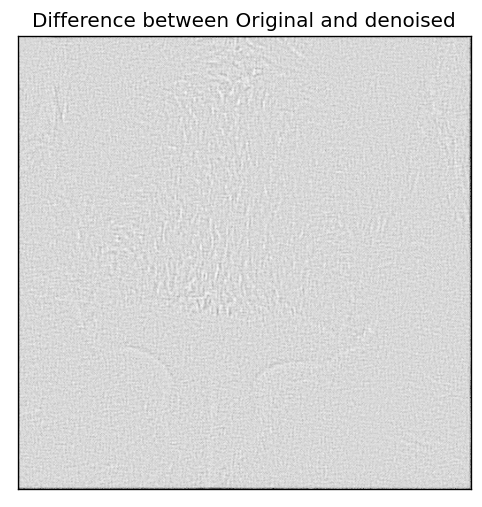

In [76]:
plt.figure(figsize=(5,5))
plt.xticks([])
plt.yticks([])
plt.imshow(denoised_cv - denoised, cmap=plt.cm.Greys)
plt.title('Difference between Original and denoised')

## Bilateral Filter (Color) (2 marks)

Extend the Bilateral filter to colour images (eg. The color version of the previous grayscale image.). For this you may need to consider the CIE-Lab colour space as described in the paper. You will need to explore this for yourself. Namely, You need to generate the noisy color image and implement the bilateral filter to the color image (CIE-Lab). (2.0 marks) (Note this task is more difficult again).

Tomasi, C; Manduchi, R (1998). Bilateral filtering for gray and color images (PDF). Sixth International Conference on Computer Vision. Bombay. pp. 839846.

In [95]:
img = plt.imread(f'images/image2.jpg')

target_res = (512, 512)
n_rows, n_cols = img.shape[:-1]
x = (n_rows // 2) - (target_res[0] // 2)
y = (n_cols // 2) - (target_res[1] // 2)

horizontal_offset = 100
vertical_offset = -300

img = np.copy(img[x+horizontal_offset:x+target_res[0]+horizontal_offset,y+vertical_offset:y+target_res[1]+vertical_offset])
img = img / 255

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Original image with gaussian noise')

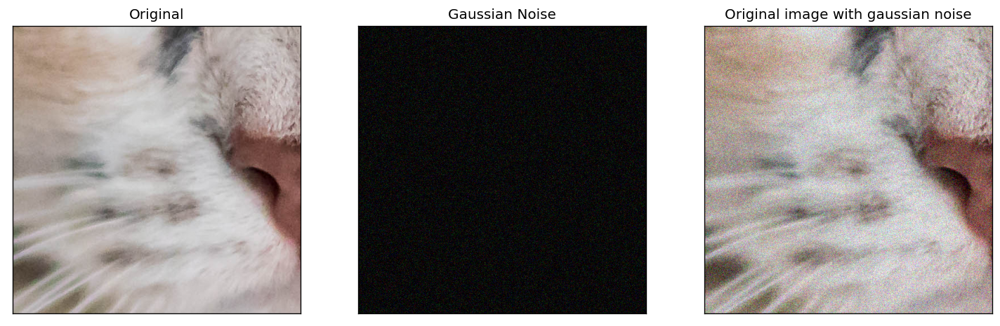

In [78]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.title('Original')

noise = np.random.normal(0, 0.1, size=img.shape)
plt.subplot(1, 3, 2)
plt.imshow(noise)
plt.xticks([])
plt.yticks([])
plt.title('Gaussian Noise')

noisy_img = img + noise
noisy_img = np.clip(noisy_img, 0, 1)
plt.subplot(1, 3, 3)
plt.imshow(noisy_img)
plt.xticks([])
plt.yticks([])
plt.title('Original image with gaussian noise')

In [79]:
noisy_img.shape

(512, 512, 3)

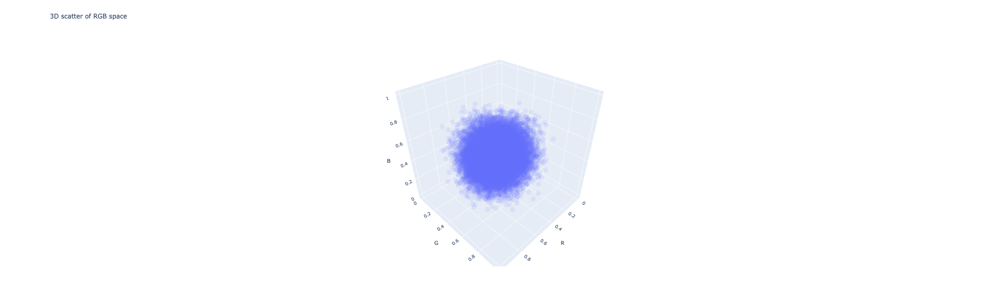

In [80]:
df_rgb = pd.DataFrame(noisy_img.reshape((noisy_img.shape[0] * noisy_img.shape[1], noisy_img.shape[2])), columns=['R', 'G', 'B'])
px.scatter_3d(df_rgb.sample(frac=0.1), x='R', y='G', z='B', opacity=0.1, width=1000, height=800, title='3D scatter of RGB space')

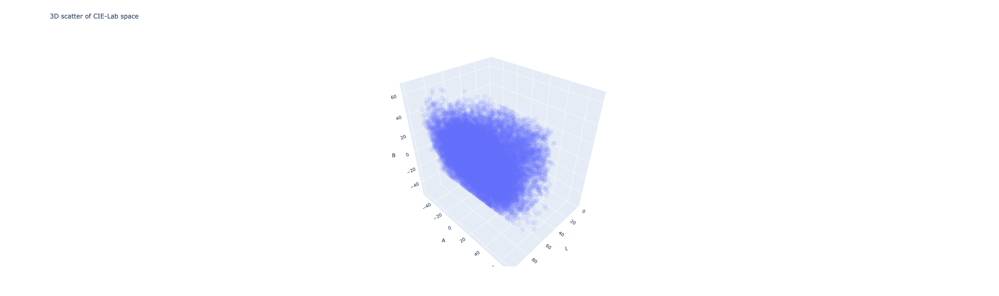

In [81]:
noisy_img_cie = cv2.cvtColor(noisy_img.astype(np.float32), cv2.COLOR_RGB2LAB)
df_lab = pd.DataFrame(noisy_img_cie.reshape((noisy_img_cie.shape[0] * noisy_img_cie.shape[1], noisy_img_cie.shape[2])), columns=['L', 'A', 'B'])
px.scatter_3d(df_lab.sample(frac=0.1), x='L', y='A', z='B', opacity=0.1, width=1000, height=800, title='3D scatter of CIE-Lab space')

In [82]:
def bilateral_filter(img, kernel_s, sigma_r):    
    padding = kernel_s.shape[0] // 2
    padded_img = np.pad(img, ((padding, padding), (padding, padding), (0, 0)))
    new_img = np.zeros(padded_img.shape)
    
    for i in range(padding, len(padded_img) - padding):
        for j in range(padding, len(padded_img[0]) - padding):
            # create intensity kernel_r
            color_similarities = np.sqrt(
                np.sum(
                    (padded_img[i-padding:i+padding+1, j-padding:j+padding+1] - padded_img[i,j]) ** 2,
                    axis=2
                )
            )

            kernel_r = stats.norm.pdf(color_similarities, loc=0, scale=sigma_r)

            # multiply the filters with corresponding region in image, then divide by sum of product of kernels to normalize
            new_img[i][j] = np.sum(
                padded_img[i-padding:i+padding+1, j-padding:j+padding+1, k] * kernel_s * kernel_r
            ) / np.sum(kernel_s * kernel_r)
            
    return new_img[padding:padding+img.shape[0], padding:padding+img.shape[1]]

In [83]:
# sigma_s = 15 # space
# sigma_r = 0.4 # intensity
# kernel_size = (5, 5,)
# kernel_s = create_filter(sigma_s, kernel_size)
# denoised_color = bilateral_filter(noisy_img_cie, kernel_s, sigma_r)

### OpenCV

Text(0.5, 1.0, 'OpenCV Bilateral Filter (CIE-Lab space)\nkernel_size=10, sigma_r=40, sigma_s=10')

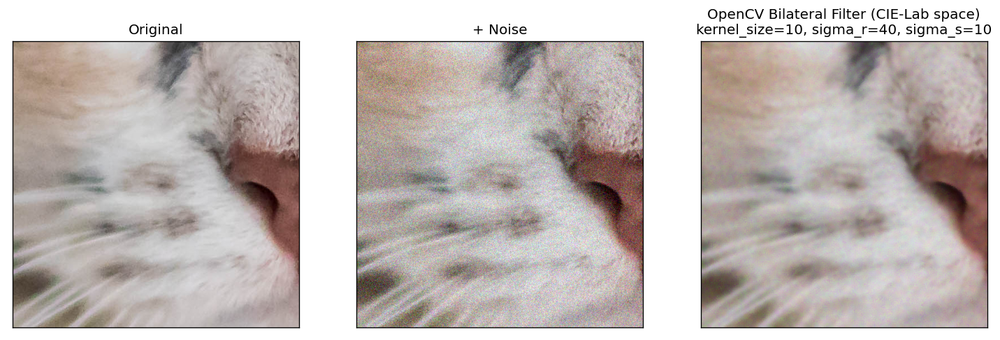

In [84]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.title('Original')

plt.subplot(1, 3, 2)
plt.imshow(noisy_img)
plt.xticks([])
plt.yticks([])
plt.title('+ Noise')

diameter = 10
sigma_r = 40
sigma_s = 10
denoised_cv2_cie = cv2.bilateralFilter(noisy_img_cie, diameter, sigma_r, sigma_s)

plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(denoised_cv2_cie, cv2.COLOR_LAB2RGB))
plt.xticks([])
plt.yticks([])
plt.title(f'OpenCV Bilateral Filter (CIE-Lab space)\nkernel_size={diameter}, sigma_r={sigma_r}, sigma_s={sigma_s}')

Text(0.5, 1.0, 'OpenCV Bilateral Filter (RGB space)\nkernel_size=10, sigma_r=0.3, sigma_s=10')

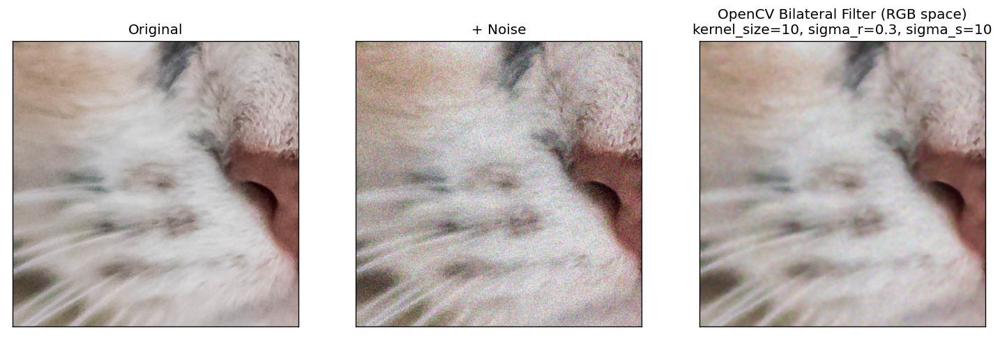

In [85]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.title('Original')

plt.subplot(1, 3, 2)
plt.imshow(noisy_img)
plt.xticks([])
plt.yticks([])
plt.title('+ Noise')

diameter2 = 10
sigma_r2 = 0.3
sigma_s2 = 10
denoised_cv2_rgb = cv2.bilateralFilter(noisy_img.astype(np.float32), diameter2, sigma_r2, sigma_s2)

plt.subplot(1, 3, 3)
plt.imshow(denoised_cv2_rgb)
plt.xticks([])
plt.yticks([])
plt.title(f'OpenCV Bilateral Filter (RGB space)\nkernel_size={diameter2}, sigma_r={sigma_r2}, sigma_s={sigma_s2}')

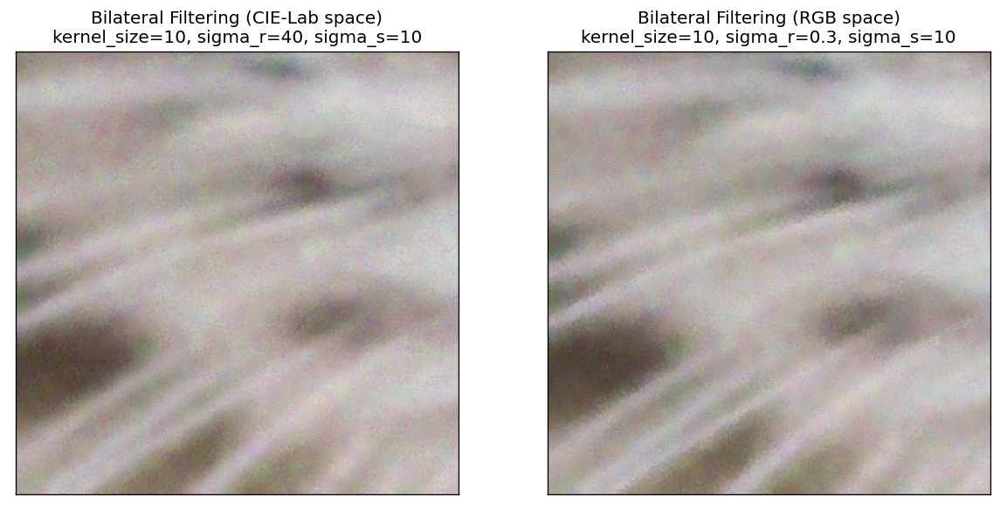

In [86]:
compare_two_images(
    label_img={
        f'Bilateral Filtering (CIE-Lab space)\nkernel_size={diameter}, sigma_r={sigma_r}, sigma_s={sigma_s}': cv2.cvtColor(denoised_cv2_cie[256:,:256], cv2.COLOR_LAB2RGB), 
        f'Bilateral Filtering (RGB space)\nkernel_size={diameter2}, sigma_r={sigma_r2}, sigma_s={sigma_s2}': denoised_cv2_rgb[256:,:256]
    }
)

## Impact

In up to half a page, discuss the impact of smoothing on colour. What are the difficulties of smoothing in RGB colour space? Why is CIE-Lab space a good idea for this smoothing? (Compare images smoothed in CIE-Lab space vs RGB) Does the bilateral filter itself help? You may want to compare Gaussian smoothed colour images and bilateral filtered ones, and investigate filtering in different colour spaces. For this you can use your processed images as examples, possibly cropping and enhancing detail in your report to illustrate your discussion. (1 marks)

Bilateral filtering improves on Gaussian filter by taking color similarity into account, in addition to pixel proximity. With this approach, pixels that are closer to the center of the kernel will be given higher weights; however, if the color is very different from the center pixel, the pixel might be given a lower weight (or not be blurred). In order to measure the color similarity, euclidian distance (l2 distance) is used. Since RGB space is highly correlated, colors that are perceptually different may be in close proximity to each other in this space. In theory, this makes RGB space unfavorable for bilateral filtering, and CIE-Lab color space is typically used instead. In CIE-Lab color space, change in the values that make up a color also reflect the perceptual difference, making distance measured between colors more perceptually meaningful. In the particular image and region selected for comparison, bilateral filtering seemed to achieve identical results despite using RGB space and CIE-Lab space.

# Task 6: Image Translation (3 marks)

## 1

In [100]:
offset = np.random.randint(-100, 100, size=(2,))
offset

array([49, 99])

In [101]:
def my_translation(img, offset):
    new_img = np.zeros(img.shape)
    
    for i in range(len(img)):
        for j in range(len(img[0])):
            x, y = int(i + offset[0]), int(j + offset[1])
            if 0 <= x < len(img) and 0 <= y < len(img[0]):
                new_img[x][y] = img[i][j]
    return new_img

In [102]:
translated = my_translation(cropped, offset)

Text(0.5, 1.0, 'Translated: [49 99]')

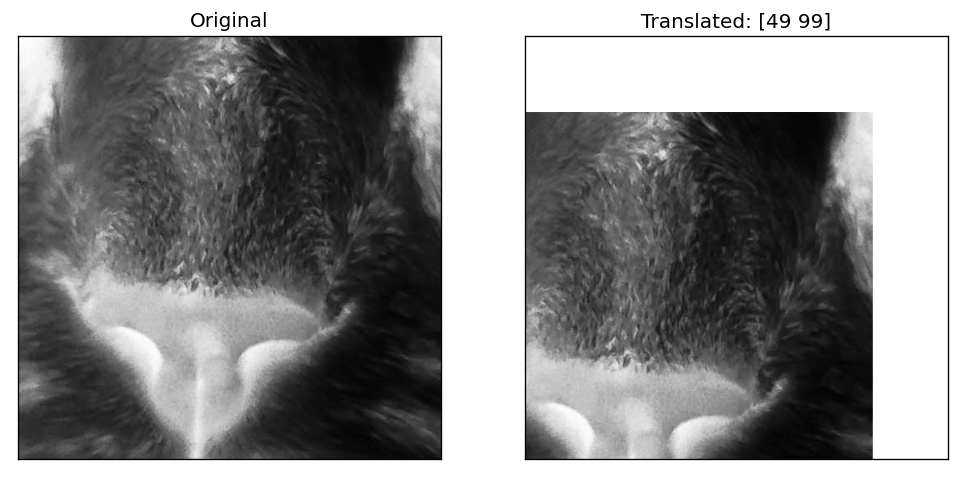

In [103]:
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.xticks([])
plt.yticks([])
plt.imshow(cropped, cmap=plt.cm.Greys)
plt.title('Original')

plt.subplot(1, 2, 2)
plt.xticks([])
plt.yticks([])
plt.imshow(new_img, cmap=plt.cm.Greys)
plt.title(f'Translated: {offset}')

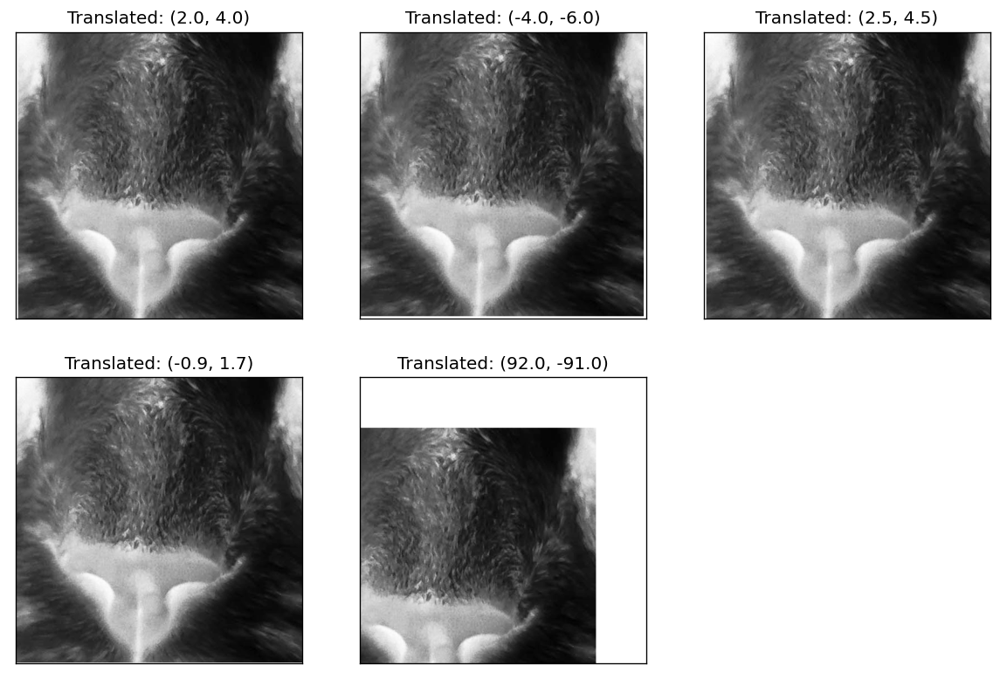

In [104]:
plt.figure(figsize=(12, 8))
for i, off in enumerate([(2.0,4.0), (-4.0,-6.0), (2.5,4.5), (-0.9,1.7), (92.0,-91.0)], 1):
    new_img = my_translation(cropped, off)
    plt.subplot(2, 3, i)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(new_img, cmap=plt.cm.Greys)
    plt.title(f'Translated: {off}')

## 2. Compare forward and backward mapping and analyze their difference (1.0 mark).

In [105]:
def my_translation_inverse(img, offset):
    tolerance = 0.2
    
    new_img = np.zeros(img.shape)
    
    for i in range(len(new_img)):
        for j in range(len(new_img[0])):
            
            x, y = i - offset[0], j - offset[1]
            int_x, int_y = int(x), int(y)
            
            if 0 <= x < len(new_img) and 0 <= y < len(new_img[0]):
                if x % 1 > tolerance and y % 1 > tolerance and (int_x < len(img) - 1) and (int_y < len(img[0]) - 1):
                    new_img[i][j] = img[int_x:int_x+2, int_y:int_y+2].mean()
                elif x % 1 > tolerance or y % 1 > tolerance:
                    if x % 1 > tolerance and int_x < len(img) - 1:
                        new_img[i][j] = img[int_x:int_x+2,int_y].mean()
                    elif y % 1 > tolerance and int_y < len(img[0]) - 1:
                        new_img[i][j] = img[int_x,int_y:int_y+2].mean()
                else:
                    new_img[i][j] = img[int_x][int_y]

    return new_img

In [106]:
translated_inv = my_translation_inverse(cropped, offset)

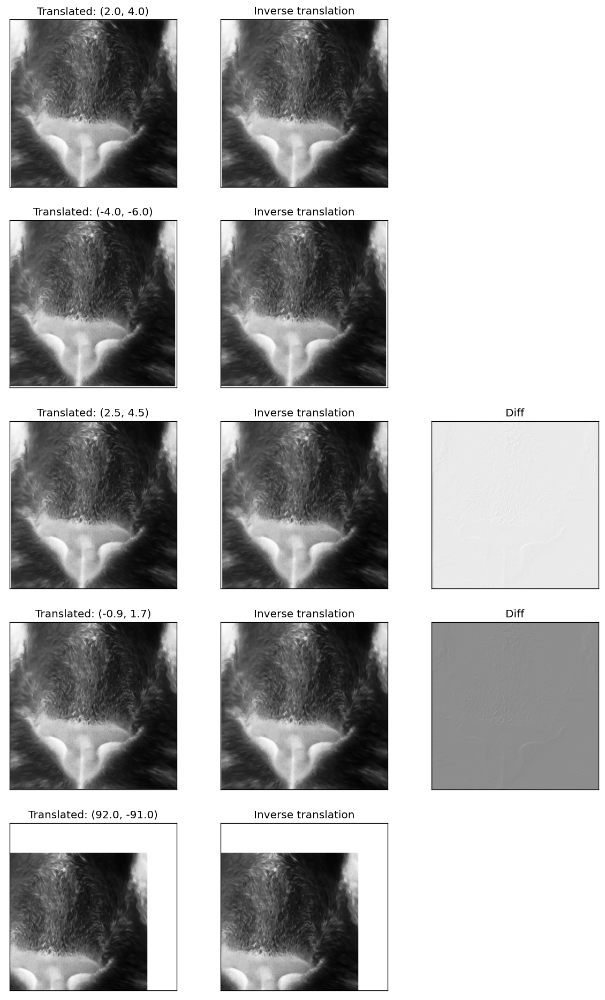

In [107]:
plt.figure(figsize=(12, 20))
i = 0

for off in [(2.0,4.0), (-4.0,-6.0), (2.5,4.5), (-0.9,1.7), (92.0,-91.0)]:
    i += 1
    new_img = my_translation(cropped, off)
    plt.subplot(5, 3, i)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(new_img, cmap=plt.cm.Greys)
    plt.title(f'Translated: {off}')
    
    i += 1
    translated_inv = my_translation_inverse(cropped, off)
    plt.subplot(5, 3, i)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(translated_inv, cmap=plt.cm.Greys)
    plt.title('Inverse translation')
    
    # highlight differences
    i += 1
    if (new_img != translated_inv).any():
        plt.subplot(5, 3, i)
        plt.xticks([])
        plt.yticks([])

        plt.imshow((new_img - translated_inv), cmap=plt.cm.Greys)
        plt.title('Diff')

## 3. Compare different interpolation methods and analyze their difference (1.0 mark).

Hint: When analyzing the difference, you can focus on: 

- (1) visual results; 
- (2) the principles in terms of formulation or others relevant; 
- (3) advantages and drawbacks; 
- (4) the computational complexity. You can also think about it from other aspects.